# **New Business Location Use Case**

**Authored by:** Steven Tuften

**Duration:** 90 mins

**Level:** Intermediate

**Pre-requisite Skills:**  Python 


**Scenario:**

- **As a Cafe, Restaurant, or Bar Owner**:
  - I am seeking commercial space in the City of Melbourne to either open a new venue or expand an existing one.
- **Objective**:
  - I want to identify where similar businesses are located in the City of Melbourne.
  - I am interested in comparing the density of residents and office workers in those areas.
- **Outcome**:
  - I want to know the number of seats I should provide based on the seating capacity of other similar establishments in the same area.


**What this use case will teach you**

At the end of this use case you will:
- understand what CLUE data is and how to access it
- have explored a dataset derived from the CLUE survey
- learnt how to visualise CLUE data using different mapping visualisation techniques

## **A brief introduction to CLUE data**

The City of Melbourne conducts a comprehensive bi-annual survey of its residents and businesses called the "Census of Land Use and Employment (CLUE)". CLUE captures key information on land use, employment, and economic activity across the City of Melbourne.

CLUE datasets are a valuable tool for businesses looking to invest in the City of Melbourne and for researchers wanting to understand those factors that influence and shape the social and economic dynamics of Australia's second largest metropolis and one of the world's most liveable cities.

CLUE data assists the City of Melbourne's business planning, policy development and strategic decision making. Investors, consultants, students, urban researchers, property analysts, businesses and developers can take advantage of CLUE to understand customers, the marketplace and the changing form and nature of the city.

**Source:** __[CLUE]( https://data.melbourne.vic.gov.au/stories/s/CLUE/rt3z-vy3t?src=hdr)__

This use case utilises various CLUE datasets to illustrate their value to Data Scientists, Researchers and Software Developers.

**CLUE Geospatial Data**

CLUE Data is often coded to a specific location (Latitude and Longitude) and/or to a City precinct, referred to as the "CLUE small area". Datasets may also include the individual city block within a precinct referred to by its CLUE Block ID.

The geospatial coordinates describing these areas as polygons can be downloaded in GeoJSON format and used to show shaded areas on a map, known as a choropleth map. This can be a useful technique for illustrating broad trends or statistics for a city area rather than a specific location.

A map visualisation of CLUE Blocks and small areas can be found at the following links:
- __[CLUE small areas](https://data.melbourne.vic.gov.au/Business/Small-Areas-for-Census-of-Land-Use-and-Employment-/gei8-3w86)__
- __[CLUE Blocks](https://data.melbourne.vic.gov.au/Business/Blocks-for-Census-of-Land-Use-and-Employment-CLUE-/aia8-ryiq)__


<div class="usecase-section-header">Which CLUE data should I use?</div>

To begin we shall first import the necessary libraries to support our exploratory data analysis and visualisation of the CLUE data.

The following are core packages required for this exercise:

- The plotly.express package lets use build interact maps using map box services.

## **1. Data Loading and Examination**

### **Required Libraries and Packages**

In [1]:
import os                        # For file paths and OS interaction
import time                      # For tracking time
import requests                  # For making HTTP requests
from io import StringIO           # For in-memory file operations
from datetime import datetime     # For date and time handling
import numpy as np                # For numerical computations
import pandas as pd               # For data manipulation and analysis
import plotly.graph_objs as go     # For detailed interactive plots
import plotly.express as px        # For simple interactive visualizations
import geopandas as gpd
import json

### **1.0 Dataset Imported through API**

In [2]:
#Function to collect data
def API_Unlimited(datasetname): # pass in dataset name and api key
    dataset_id = datasetname

    base_url = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'
    #apikey = api_key
    dataset_id = dataset_id
    format = 'csv'

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,  # all records
        'lang': 'en',
        'timezone': 'UTC'
    }

    # GET request
    response = requests.get(url, params=params)

    if response.status_code == 200:
        # StringIO to read the CSV data
        url_content = response.content.decode('utf-8')
        datasetname = pd.read_csv(StringIO(url_content), delimiter=';')
        print(datasetname.sample(10, random_state=999)) # Test
        return datasetname
    else:
        return (print(f'Request failed with status code {response.status_code}'))

**Function Summary: API_Unlimited**

The `API_Unlimited` function retrieves a dataset from the Melbourne Open Data API and returns it as a pandas DataFrame. The function constructs the API URL using a dataset name, sends a GET request, and if successful, reads the CSV data into a DataFrame. It retrieves all records from the dataset and prints a sample of 10 rows for verification. If the request fails, an error message with the status code is displayed.

**Key Points**:
- Fetches entire dataset using the API.
- Handles CSV data via a GET request.
- Returns data as a pandas DataFrame for further analysis.

### **1.1fetch_geojson_dataset_API**

In [3]:
def fetch_geojson_dataset_API(dataset_id): # pass in dataset name and api key

    base_url = 'https://data.melbourne.vic.gov.au/api/v2/catalog/datasets/'
    #output format is made according to COM
    format = 'geojson' # JSON , CSV , ECT..... -----------------IMPORTANT

    url = f'{base_url}{dataset_id}/exports/{format}'
    params = {
        'select': '*',
        'limit': -1,  # all records
        'lang': 'en',
        'timezone': 'UTC'
    }
    #GET
    response = requests.get(url)

    if response.status_code == 200:
        geojson_data = gpd.read_file(response.text)
        return geojson_data
    else:
        print(f'Request failed with status code {response.status_code}')
        return None

**Function Summary: fetch_geojson_dataset_API**

The `fetch_geojson_dataset_API` function is designed to fetch data in **GeoJSON** format from the Melbourne Open Data API. The function takes the `dataset_id` as input, constructs the API request URL, and retrieves the GeoJSON data. If successful, the function returns the data as a **GeoPandas** GeoDataFrame, which can be used for spatial analysis. If the request fails, it prints the status code of the failure.

**Key Points**:
- Fetches data from the API in **GeoJSON** format.
- Uses a GET request to retrieve all records (`limit=-1`).
- Returns the dataset as a GeoPandas GeoDataFrame for spatial analysis.
- Prints an error message with the status code if the request fails.


#### 1.1.0 Fetch Residential Dwellings Dataset

In this code, the following actions are performed:

- **`dataset_id_1`**: The variable `dataset_id_1` is assigned the string `'residential-dwellings'`, which represents the dataset identifier for the "residential dwellings" dataset on the Melbourne Open Data platform.
  
- **`API_Unlimited(dataset_id_1)`**: The function `API_Unlimited()` is called with `dataset_id_1` as the argument. This function fetches the dataset named `'residential-dwellings'` from the Melbourne Open Data API and returns the data as a pandas DataFrame.

- **`res_dataset`**: The returned data from the `API_Unlimited()` function is stored in the variable `res_dataset`, which now contains the full dataset for further analysis.

**Summary**: 
The code snippet retrieves the "residential dwellings" dataset from the Melbourne Open Data platform using the `API_Unlimited` function and stores the data in the `res_dataset` variable for analysis.


In [4]:
dataset_id_1 = 'residential-dwellings'
res_dataset = API_Unlimited(dataset_id_1)


        census_year  block_id  property_id  base_property_id  \
52936          2019       517       107028            107028   
164738         2016      2391       617237            617237   
129892         2002       349       102363            102363   
6938           2016       203       109350            109350   
78980          2019       370       103494            103494   
60032          2011       525       105216            105216   
151863         2012       510       104640            104640   
44513          2002       228       107721            107721   
42587          2003       368       105626            105626   
17224          2010       858       106737            106737   

                                  building_address  clue_small_area  \
52936         59 Ormond Street KENSINGTON VIC 3031       Kensington   
164738  10-20 Caytre Crescent NORTH MELBOURNE 3051  North Melbourne   
129892      142 Curzon Street NORTH MELBOURNE 3051  North Melbourne   
6938       

### **1.1.1 Filter for Year 2020**: 
  - The dataset `res_dataset` is filtered to only include records where the `census_year` is 2020. This ensures that the analysis focuses solely on data from the year 2020.

In [5]:
#Filter Residential dataset for only year 2020
res_dataset = res_dataset[res_dataset["census_year"] == 2020]

#rename the columns to match the columns named by original coder Steven Tuften. As well, to change the dataset to match the column order
res_dataset.rename(columns={'property_id': 'pbs_property_id', 'base_property_id': 'bps_base_id',"building_address":"street_name","longitude":"x_coordinate","latitude":"y_coordinate"}, inplace=True)
columns_list = ["census_year","block_id","pbs_property_id","bps_base_id","street_name","clue_small_area","dwelling_type","dwelling_number","x_coordinate","y_coordinate"]
res_dataset = res_dataset[columns_list]

Next, we will look at one of the CLUE datasets to better understand its structure and how we can use it.

Our data requirements from this use case include the following:
- Number of Residential Dwellings per CLUE Block
- Number of Employees per CLUE Block
- Number of Seats (Indoor and Outdoor) per Venue and CLUE Block

For this exercise, we shall start by examining the Residential Dwelling dataset.
Each dataset in the Melbourne Open Data Portal has a unique identifier which can be used to retrieve the dataset using the sodapy library.

This dataset is placed in a Pandas dataframe and we will inspect the first three rows.

### **1.1.2 Retrieve and Display the Shape of the Dataset**

  - The `shape` attribute of the `res_dataset` DataFrame is printed to display the number of rows and columns in the dataset. This helps in understanding the dataset's size.

In [6]:
# Retrieve the "CLUE Residential Dwellings 2020" dataset

print(f'The shape of dataset is {res_dataset.shape}.')
print('Below are the first few rows of this dataset:')

# Transpose the DataFrame for easier visual comparison.
res_dataset.head(3).T

The shape of dataset is (10404, 10).
Below are the first few rows of this dataset:


,78011,78012,78013
census_year,2020,2020,2020
block_id,11,11,11
pbs_property_id,103957,103987,103989
bps_base_id,103957,103987,103989
street_name,517-537 Flinders Lane MELBOURNE VIC 3000,550-554 Flinders Street MELBOURNE VIC 3000,532-536 Flinders Street MELBOURNE VIC 3000
clue_small_area,Melbourne (CBD),Melbourne (CBD),Melbourne (CBD)
dwelling_type,Residential Apartments,Residential Apartments,Residential Apartments
dwelling_number,26,176,275
x_coordinate,144.956486,144.955969,144.956435
y_coordinate,-37.819875,-37.820399,-37.820242


### **Data Overview**

- **Dataset Size**: The dataset contains 10,403 records and 10 fields, each describing various attributes of individual residential properties.
  
- **Details of Each Record**:
  - The dataset provides the **number of dwellings** for each property along with the **type of dwelling**, such as House/Townhouse, Residential Apartments, etc.
  
- **Location Information**:
  - The location of each property is specified using:
    - **Latitude and Longitude**: Geographic coordinates to precisely locate the property.
    - **CLUE Small Area and Block ID**: Area-based identifiers used for the CLUE analysis.
    - **Property ID**: A unique identifier for each property.

- **Census Year**:
  - The **Census year** is included in the dataset, showing when the data was collected. For this analysis, it focuses on the **2020 CLUE Census**.

- **Analysis Scope**:
  - For our analysis of this dataset and others, we will be restricting the analysis to the **2020 CLUE Census** and summarizing the data at the **CLUE Block level**.


## **2 Summarising Residential Dwelling data**

We want to plot the density of both residential dwellings and employment at city block level rather than a specific property or address. We can use a __[choropleth map](https://en.wikipedia.org/wiki/Choropleth_map)__ to do this.

Let's start by summarising the data at CLUE small area and Block level.

**Note:** We include CLUE Small Area as one of our group by fields so we can display the CLUE Small area name in the popup window when you hover over the area on the map.

We want to summarise the data by summing the number of dwellings across all rows in the same CLUE Block.

The following cell creates a dataframe containing this summary of residential dwellings.

This code processes the **CLUE Residential Dwellings 2020** dataset by ensuring proper data types and creating an aggregated dataset based on the number of dwellings per block:

- **Casting Data Types**: 
  - Columns such as `census_year` and `dwelling_number` are cast to **integer**, while `x_coordinate` and `y_coordinate` (latitude and longitude) are cast to **float** to allow accurate numerical and geographic operations.
  - Remaining columns are converted to their optimal types using `convert_dtypes()`.

- **Aggregation**:
  - The dataset is grouped by `block_id` and `clue_small_area` to calculate the **total number of dwellings** for each block using the `dwelling_number` field.
  - This aggregated dataset shows the sum of dwellings per block, allowing for a more granular analysis of residential distribution.

- **Flattening Grouped Columns**:
  - After the group-by operation, column headers are flattened to simplify their structure.
  - The columns `clue_small_area` and `dwelling_numbersum` are renamed to **`clue_area`** and **`dwelling_count`** respectively for clarity.

**Output**:
The resulting dataset provides a summarized view of the total number of dwellings per block and clue area, ready for visualization and further analysis.


In [7]:
# Cast datatypes to correct type so we can summarise
res_dataset[['census_year', 'dwelling_number']] = res_dataset[['census_year', 'dwelling_number']].astype(int)
res_dataset[['x_coordinate', 'y_coordinate']] = res_dataset[['x_coordinate', 'y_coordinate']].astype(float)
res_dataset = res_dataset.convert_dtypes() # convert remaining to string
res_dataset.dtypes

# create the aggregate dataset
groupbyfields = ['block_id','clue_small_area']
aggregatebyfields = {'dwelling_number': ["sum"]}

dwellingsByBlock = pd.DataFrame(res_dataset.groupby(groupbyfields, as_index=False).agg(aggregatebyfields))

# Dataframse Group by creates two levels of headings
# so we flatten the headings to make it easier to extract data for plotting
dwellingsByBlock.columns = dwellingsByBlock.columns.map(''.join) # flatten column header
dwellingsByBlock.rename(columns={'clue_small_area': 'clue_area'}, inplace=True) #rename to match GeoJSON extract
dwellingsByBlock.rename(columns={'dwelling_numbersum': 'dwelling_count'}, inplace=True)
dwellingsByBlock.head(5)

,block_id,clue_area,dwelling_count
0,1,Melbourne (CBD),385
1,11,Melbourne (CBD),690
2,12,Melbourne (CBD),190
3,13,Melbourne (CBD),112
4,14,Melbourne (CBD),99


## **3 Visualising Residential Dwelling on a Choropleth Map**

We use the __[Plotly Python Open Source Graphing Library](https://plotly.com/python/)__ to generate maps from __[mapbox](https://www.mapbox.com/)__.

Creating a choropleth map requires us to know the geometry(shape) of each CLUE Block area as a collection of latitude and longitude points defining a polygon. This data can be downloaded from the Melbourne Open Data Portal in __[GeoJSON](https://en.wikipedia.org/wiki/GeoJSON)__ format.

We also need to supply the data to be used to highlight the CLUE Blocks and that data must include the same unique identifier for each Block contained in the GeoJSON data set.

Below we extract the Melbourne CLUE Block polygons into a GeoJSON datatype.

In [8]:
dataset_id_2 = 'blocks-for-census-of-land-use-and-employment-clue'
block = fetch_geojson_dataset_API(dataset_id_2)
#block = gpd.read_file('https://data.melbourne.vic.gov.au/api/v2/catalog/datasets/blocks-for-census-of-land-use-and-employment-clue/exports/geojson')
block

,geo_point_2d,block_id,clue_area,geometry
0,"{'lon': 144.95049282288122, 'lat': -37.8229616...",1112,Docklands,"POLYGON ((144.94792 -37.82337, 144.94809 -37.8..."
1,"{'lon': 144.94085920366408, 'lat': -37.7853742...",927,Parkville,"POLYGON ((144.94262 -37.78663, 144.94250 -37.7..."
2,"{'lon': 144.94600024715058, 'lat': -37.7776873...",929,Parkville,"POLYGON ((144.94259 -37.77872, 144.94436 -37.7..."
3,"{'lon': 144.94361235073427, 'lat': -37.7967014...",318,North Melbourne,"POLYGON ((144.94472 -37.79613, 144.94177 -37.7..."
4,"{'lon': 144.94371829763847, 'lat': -37.7929397...",302,North Melbourne,"POLYGON ((144.94539 -37.79253, 144.94229 -37.7..."
...,...,...,...,...
601,"{'lon': 144.93946493667673, 'lat': -37.7885616...",2381,North Melbourne,"POLYGON ((144.94001 -37.78917, 144.94028 -37.7..."
602,"{'lon': 144.94097451585088, 'lat': -37.7916039...",2386,North Melbourne,"POLYGON ((144.94223 -37.79249, 144.94229 -37.7..."
603,"{'lon': 144.94103507813242, 'lat': -37.7948232...",2392,North Melbourne,"POLYGON ((144.94015 -37.79559, 144.94022 -37.7..."
604,"{'lon': 144.93888979074072, 'lat': -37.7898979...",2383,North Melbourne,"POLYGON ((144.94001 -37.78917, 144.93860 -37.7..."


## **4 Display the choropleth map**

Now using just one function call called 'choropleth_mapbox' we can display an interactive map using the **block** GeoJSON data to define the regions and the **dwellingsByBlock** dataframe to define the summarised data by block.

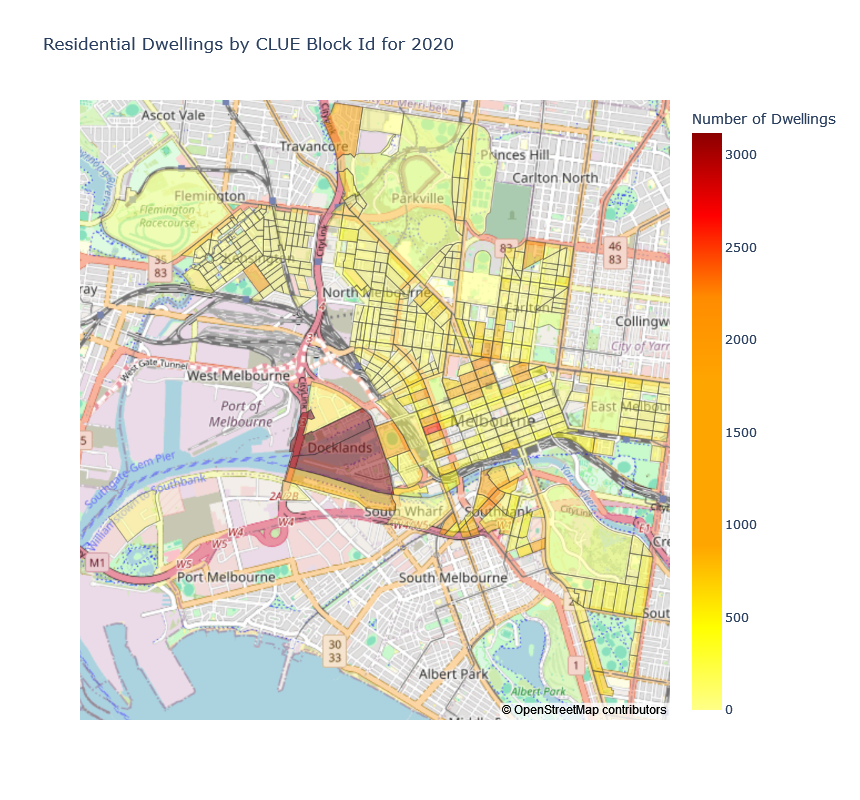

In [9]:
fig = px.choropleth_mapbox(dwellingsByBlock, 
                           geojson=block, 
                           locations='block_id', 
                           color='dwelling_count', 
                           color_continuous_scale=["#FFFF88", "yellow", "orange", "orange",
                                                   "orange", "darkorange", "red", "darkred"], 
                           range_color=(0, dwellingsByBlock['dwelling_count'].max()), 
                           featureidkey="properties.block_id", 
                           mapbox_style="open-street-map",  # Changed map style to a simpler one
                           zoom=12.15, 
                           center={"lat": -37.813, "lon": 144.945}, 
                           opacity=0.5, 
                           hover_name='clue_area', 
                           hover_data={'block_id':True,'dwelling_count':True}, 
                           labels={'dwelling_count':'Number of Dwellings','block_id':'CLUE Block Id'}, 
                           title='Residential Dwellings by CLUE Block Id for 2020', 
                           width=950, height=800 
                          )
fig.show()


You've successfully used Melbourne CLUE Open Data and Plotly to visualise residential density in the City of Melbourne!<br>
Now zoom in and out on the map above to explore the city and areas of high and low residential density.<br><br>
This is your first step to selecting a suitable location for your new business!

__You can explore the Residential Density data [Click here](../dataanalysis/eda-clue-residentialdwellings.ipynb)__.

## **5 Visualising Residential Density and Cafe or Restaurant Seating**

To build our view of cafe venue seating and how it relates to residential density we need to visualise both datasets on the same interactive map view.

We can do this by adding a new layer (or "trace" as it is called in Plotly) to our previous map of residential density.

Let's extract the Melbourne CLUE cafe, restaurant, bistro seats dataset and summarise it so its ready to plot.

In [10]:
# Pull dataset for Cafe, restaurant and bistro seat dataset
dataset_id_3 = 'cafes-and-restaurants-with-seating-capacity'
cafe_dataset = API_Unlimited(dataset_id_3)
#Filter cafe dataset for 2020
cafe_dataset = cafe_dataset[cafe_dataset["census_year"] == 2020]

# Cast columns to correct data type
cafe_dataset.rename(columns={"longitude":"x_coordinate","latitude":"y_coordinate"},inplace=True)
integer_columns = ['census_year', 'block_id', 'property_id', 'base_property_id', 'industry_anzsic4_code', 'number_of_seats']
fp_columns = ['x_coordinate', 'y_coordinate']
cafe_dataset[integer_columns] = cafe_dataset[integer_columns].astype(int)
cafe_dataset[fp_columns] = cafe_dataset[fp_columns].astype(float)
cafe_dataset = cafe_dataset.convert_dtypes() # convert remaining to string

# Summarise venue seating by location
groupbyfields = ['clue_small_area','block_id','y_coordinate','x_coordinate']
aggregatebyfields = {'number_of_seats': ["sum"]}

seatsByLocn = pd.DataFrame(cafe_dataset.groupby(groupbyfields, as_index=False).agg(aggregatebyfields))
seatsByLocn.columns = seatsByLocn.columns.map(''.join) # flatten column header
seatsByLocn.rename(columns={'clue_small_area': 'clue_area'}, inplace=True) #rename to match GeoJSON extract
seatsByLocn.rename(columns={'number_of_seatssum': 'number_of_seats'}, inplace=True) #rename to match GeoJSON extract
seatsByLocn['number_of_seats'] = seatsByLocn['number_of_seats'].astype(int)

# Calculate scale for drawing each bubble on scatter map plot
all_data_diffq = (seatsByLocn["number_of_seats"].max() - seatsByLocn["number_of_seats"].min()) / 16
seatsByLocn['scale'] = (seatsByLocn["number_of_seats"] - seatsByLocn["number_of_seats"].min()) / all_data_diffq + 1
seatsByLocn['scale'] = seatsByLocn['scale'].astype(int)+2
seatsByLocn.head(10)

       census_year  block_id  property_id  base_property_id  \
33589         2021        21       579252            579252   
53701         2015        58       105656            105656   
12141         2012       920       104437            104437   
1603          2018        65       105875            105875   
13239         2013      1110       620312            593737   
12506         2013        48       101109            101109   
49854         2021        72       105375            105375   
45230         2005        45       101142            101142   
47447         2020        55       109285            109285   
9747          2021       263       101243            101243   

                                  building_address  clue_small_area  \
33589    559-587 Collins Street MELBOURNE VIC 3000  Melbourne (CBD)   
53701        11-19 Liverpool Street MELBOURNE 3000  Melbourne (CBD)   
12141        300-328 Grattan Street PARKVILLE 3050        Parkville   
1603   318-322 Little 

,clue_area,block_id,y_coordinate,x_coordinate,number_of_seats,scale
0,Carlton,203,-37.796707,144.965534,51,3
1,Carlton,203,-37.79668,144.9649,42,3
2,Carlton,204,-37.797834,144.965174,50,3
3,Carlton,204,-37.797255,144.965754,120,3
4,Carlton,205,-37.799463,144.964894,96,3
5,Carlton,205,-37.799001,144.964765,80,3
6,Carlton,205,-37.798721,144.965257,41,3
7,Carlton,206,-37.800458,144.966553,51,3
8,Carlton,206,-37.800191,144.966716,140,3
9,Carlton,206,-37.800046,144.966741,115,3


Above we can see our summary dataframe has calculated the total number of seats (indoor and outdoor) at each unique locations (latitude and longitude).

Since there is such a wide variance in venue seating across the city we need to scale the size of the bubbles drawn on the map to just a few (16) distinct sizes.

We set the lowest scale to 3 to ensure even the smallest venue's bubble is large enough when one zooms in at block level.

The next step is to display both the Choropleth and Scatter maps.
We first draw the choropleth map showing residential density.
We then draw the scatter plot assigning it as a trace (aka "layer") to the existing figure then show both.

## **6 Plot residential density and venue seating**

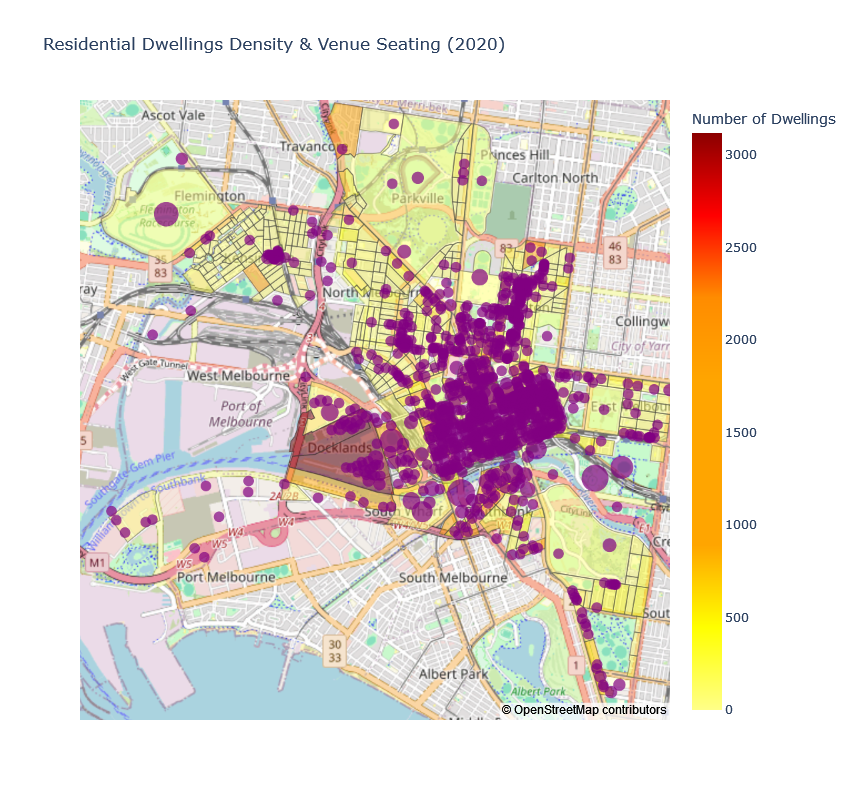

In [11]:
# Plot residential density and venue seating
fig = px.choropleth_mapbox(dwellingsByBlock, geojson=block, locations='block_id', color='dwelling_count',
                           color_continuous_scale=["#FFFF88", "yellow", "orange", "orange",
                                                   "orange", "darkorange", "red", "darkred"],
                           range_color=(0, dwellingsByBlock['dwelling_count'].max()),
                           featureidkey="properties.block_id",
                           mapbox_style="open-street-map",  # Changed to open-street-map
                           zoom=12.15,
                           center = {"lat": -37.813, "lon": 144.945},
                           opacity=0.5,
                           hover_name='clue_area',
                           hover_data={'block_id':True,'dwelling_count':True},
                           labels={'dwelling_count':'Number of Dwellings','block_id':'CLUE Block Id'},
                           title='Residential Dwellings Density & Venue Seating (2020)',
                           width=950, height=800
                          )

# Plot of venue seating
fig2 = px.scatter_mapbox(seatsByLocn, lat="y_coordinate", lon="x_coordinate", size="scale",
                        mapbox_style="open-street-map",  # Changed to open-street-map
                        zoom=12.15,
                        center = {"lat": -37.813, "lon": 144.945},
                        opacity=0.70,
                        hover_name="clue_area",
                        hover_data={"block_id":True,"scale":False,"number_of_seats":True,"x_coordinate":False,"y_coordinate":False},
                        color_discrete_sequence=['purple'],
                        labels={'number_of_seats':'Number of Seats', 'block_id':'CLUE Block Id'},
                        width=950, height=800)

# Add the venue seating layer to the residential density map
fig.add_trace(fig2.data[0])
fig.update_geos(fitbounds="locations", visible=False)

# Show the plot
fig.show()

You've successfully used Melbourne CLUE Open Data and Plotly to visualise residential density and venue seating in the City of Melbourne in one map!<br>
Now zoom in and out on the map above to explore the city and areas of high residential density but low venue seating.<br><br>
This could be a possible location for your new business!

__You can explore the Venue Seating data in more detail[Click here](../dataanalysis/eda-clue-venueseats.ipynb)__.

## **7 Building an Interactive Visualisation for New Business Location**

In the previous step we saw how we can create a new layer, also called a trace, to an existing mapbox plot in order to visualise both residential density and cafe or Restaurant venue seating on the one map.

We now wish to add Employment Density to this visualisation.
Since Employment density and Residential density both require use a choropleth map to visualise data at CLUE block level, we cannot overlay these two layers at the same time.

We therefore need a way to select the base choropleth map to show either residential density or employment density and then optionally turn on or off the venue seating as an additional scatter map box layer.

To achieve this interactivity we can make use of Plotly express functions to build a drop down menu and button to be overlaid on the map.

We will require three datasets and associated layers (traces) for this visualisation.

Let's start by extracting our third dataset titled __["Employment per industry for blocks 2020"](https://data.melbourne.vic.gov.au/Business/Employment-per-industry-for-blocks-2020/qnju-it8g)__ and performing some data preparation prior to plotting.

*Note: The ***"Employment per industry for blocks 2020"*** dataset is a summary of employment at CLUE Block level and so we do not need to perform a groupby aggregation on the dataset.*

In [12]:
# Pull dataset for the Job employment by block by clue industry
dataset_id_4 = 'employment-by-block-by-clue-industry'
jobs_dataset = API_Unlimited(dataset_id_4)
#Filter jobs dataset for 2020
jobs_dataset = jobs_dataset[jobs_dataset["census_year"] == 2020]
#rename columns
jobs_dataset.rename(columns={"total_jobs_in_block":"total_employment_in_block"}, inplace=True)
# Filter out unwanted columns
columnsToKeep = ['clue_small_area','block_id','total_employment_in_block']
employmentByBlock = jobs_dataset.filter(columnsToKeep)

# Rename to match GeoJSON extract
employmentByBlock.rename(columns={'clue_small_area': 'clue_area'}, inplace=True)

# Replace all NaNs with zero
employmentByBlock.fillna(value=0,inplace=True)

# Cast columns to correct datatype
employmentByBlock[['block_id','total_employment_in_block']] = employmentByBlock[['block_id','total_employment_in_block']].astype(int)
employmentByBlock = employmentByBlock.convert_dtypes() # convert remaining to string

# Exclude summary total for all of City of Melbourne
employmentByBlock = employmentByBlock[employmentByBlock['block_id'] > 0]

# Display sample data
employmentByBlock.head(5)

       census_year  block_id               clue_small_area  accommodation  \
2533          2010       548                    Kensington            0.0   
3598          2004       248                       Carlton           11.0   
599           2019        13               Melbourne (CBD)            0.0   
2801          2009      2517                    Kensington            0.0   
283           2021       444  West Melbourne (Residential)            0.0   
2109          2012       611                East Melbourne            0.0   
8275          2022        61               Melbourne (CBD)            NaN   
2158          2012       910                     Parkville            0.0   
10114         2013       114               Melbourne (CBD)            NaN   
690           2019       442  West Melbourne (Residential)            0.0   

       admin_and_support_services  agriculture_and_mining  \
2533                          0.0                     0.0   
3598                          

,clue_area,block_id,total_employment_in_block
396,Melbourne (CBD),6,843
397,Melbourne (CBD),11,824
398,Melbourne (CBD),14,2121
399,Melbourne (CBD),17,2124
400,Melbourne (CBD),18,6459


Now we have a dataset showing total number of employees by CLUE block, let's visualise it as a choropleth map and overlay venue seating.

In this map visualisation we will use a different map style called "open-street-map" which lets us identify the names of venues close to where the venue seating measures have been reported. **Note that not all venues may have been marked on Open Street Maps.**

Mapbox styles which do not require a Mapbox API token are 'open-street-map', 'white-bg', 'carto-positron', 'carto-darkmatter', 'stamen- terrain', 'stamen-toner', 'stamen-watercolor'. Mapbox styles which do require a Mapbox API token are 'basic', 'streets', 'outdoors', 'light', 'dark', 'satellite', 'satellite- streets'.

**Source:** __[plotly.express.line_mapbox documentation](https://plotly.com/python-api-reference/generated/plotly.express.line_mapbox.html)__

## **9 Plot employment density**

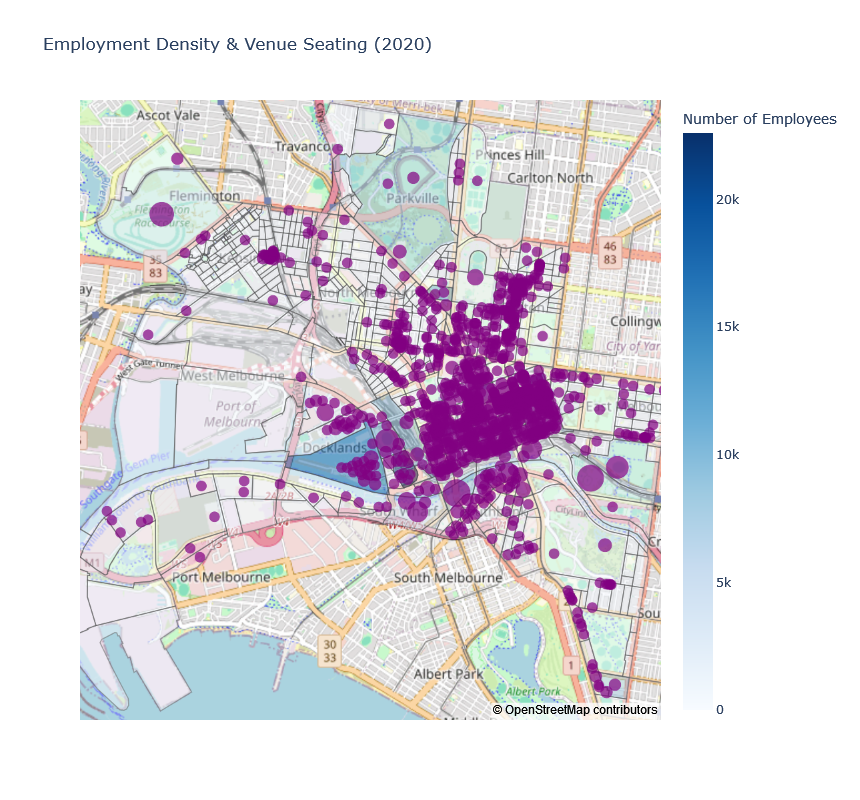

In [13]:
fig = px.choropleth_mapbox(employmentByBlock, geojson=block, locations='block_id', color='total_employment_in_block',
                           color_continuous_scale="Blues",
                           range_color=(0, employmentByBlock['total_employment_in_block'].max()),
                           featureidkey="properties.block_id",
                           mapbox_style="open-street-map",
                           zoom=12.15,
                           center = {"lat": -37.813, "lon": 144.945},
                           opacity=0.5,
                           hover_name='clue_area',
                           hover_data={'block_id':True,'total_employment_in_block':True},
                           labels={'total_employment_in_block':'Number of Employees','block_id':'CLUE Block Id'},
                           title='Employment Density & Venue Seating (2020)',
                           width=950, height=800
                          )

# Plot of venue seating
fig2 = px.scatter_mapbox(seatsByLocn, lat="y_coordinate", lon="x_coordinate", size="scale",
                        mapbox_style="stamen-toner",
                        zoom=12.15,
                        center = {"lat": -37.813, "lon": 144.945},
                        opacity=0.70,
                        hover_name="clue_area",
                        hover_data={"block_id":True,"scale":False,"number_of_seats":True,"x_coordinate":False,"y_coordinate":False},
                        color_discrete_sequence=['purple'],
                        labels={'number_of_seats':'Number of Seats', 'block_id':'CLUE Block Id'},
                        width=950, height=800)
fig.add_trace(fig2.data[0])
fig.update_geos(fitbounds="locations", visible=False)

fig.show()

## **10 Combining all map layers into one interactive map box visualisation**

Let's now build a single map box visualisation using our three datasets.

Our first step is to create a base plotly figure to which we can add each individual map plot as a new layer.

The title of the visualisation and any common parameters can be set using the fig.update_layout() method.

In the cell below we also have defined two custom colorscales, one continuous for the choropleth map and the other discrete for the scatter map plot.

We then create a figure for each dataset and add it as a layer to the base figure using the fig.add_trace() method.

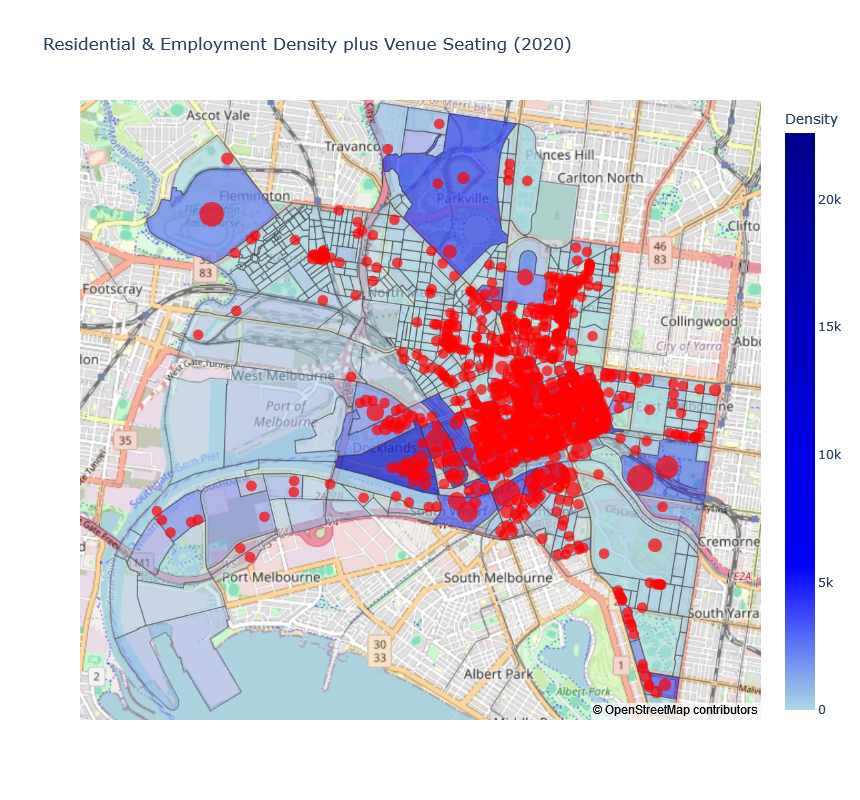

In [14]:
# Define custom colour scale for choropleth (continuous) and scatter (discrete)
custom_continuous_colorscale = [(0, "lightblue"), (0.25, "blue"), (1, "darkblue")]
custom_discrete_colorscale = ['red']

# Create the base figure to which layers(traces) will be added.
fig = go.Figure()

# Set the default style for the map
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(hovermode='closest')
fig.update_layout(mapbox_center_lat=-37.813, mapbox_center_lon=144.945, mapbox_zoom=12.15)
fig.update_layout(width=950, height=800)
fig.update_layout(title='Residential & Employment Density plus Venue Seating (2020)')
fig.update_layout(coloraxis_colorscale=custom_continuous_colorscale)
fig.update_layout(coloraxis_colorbar={'title':'Density'})

# Create the definition for the Residential Dwellings Layer
fig1 = px.choropleth_mapbox(dwellingsByBlock, geojson=block, locations='block_id', color='dwelling_count',
                           range_color=(0, dwellingsByBlock['dwelling_count'].max()),
                           featureidkey="properties.block_id",
                           hover_name='clue_area',
                           hover_data={'block_id':True,'dwelling_count':True},
                           labels={'dwelling_count':'Number of Dwellings','block_id':'CLUE Block Id'},
                           opacity=0.5,

                          )
fig.add_trace(fig1.data[0]) # add this layer to the base figure

# Create the definition for the Employment Layer
fig2 = px.choropleth_mapbox(employmentByBlock, geojson=block, locations='block_id', color='total_employment_in_block',
                           range_color=(0, employmentByBlock['total_employment_in_block'].max()),
                           featureidkey="properties.block_id",
                           hover_name='clue_area',
                           hover_data={'block_id':True,'total_employment_in_block':True},
                           labels={'total_employment_in_block':'Number of Employees','block_id':'CLUE Block Id'},
                           opacity=0.5
                          )
fig.add_trace(fig2.data[0]) # add this layer to the base figure

# Create the definition for the Venue Seating Layer
fig3 = px.scatter_mapbox(seatsByLocn, lat="y_coordinate", lon="x_coordinate", size="scale",
                        hover_name="clue_area",
                        hover_data={"block_id":True,"scale":False,"number_of_seats":True,"x_coordinate":False,"y_coordinate":False},
                        labels={'number_of_seats':'Number of Seats', 'block_id':'CLUE Block Id'},
                        opacity=0.70, color_discrete_sequence=custom_discrete_colorscale
                        )
fig.add_trace(fig3.data[0]) # add this layer to the base figure

Finally, we define buttons and text to appear along the top of the map.

Each button turns on a combination of layers when it is clicked. The layers it turns on are defined in the 'visible' arg array with the order of boolean values corresponding to the map layers in the order they were added.

For example: When the 'Residential Density & Seating' button is clicked it turns on the 1st and 3rd layer as defined by the following argument 'visible':[True, False, True] . The 1st layer was the Residential Dwelling density choropleth map and the 3rd layer was the Venue Seating Scatter map.

## **11 Turn off all choropleth layers**

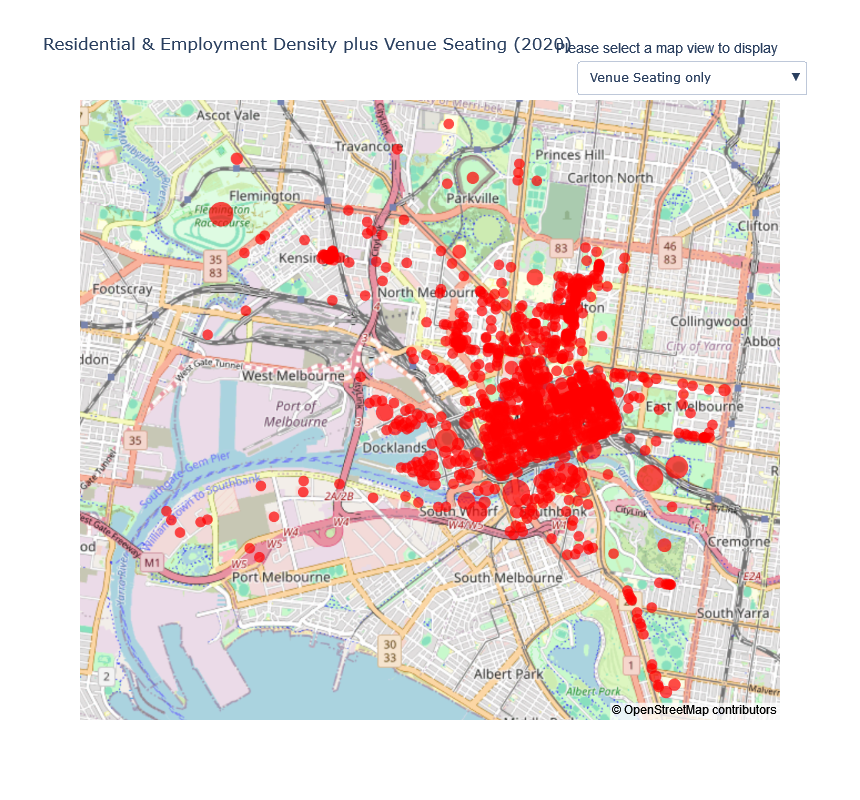

In [15]:
# Turn off all choropleth layers
fig.update_traces(visible=False, selector=dict(type='choroplethmapbox'))

# Add buttons for selection on plot
buttons = [dict(method='update',
                label='Venue Seating only',  visible=True,
                args=[{'label': 'Venue Seating', 'visible':[False, False, True]}]),
           dict(method='update',
                label='Residential Density & Seating', visible=True,
                args=[{'label': 'Residential Dwelling Density','visible':[True, False, True]}]),
           dict(method='update',
                label='Employment Density & Seating', visible=True,
                args=[{'label': 'Employment Density','visible':[False, True, True]}])
          ]

um_buttons = [{'active':0, 'showactive':True, 'buttons':buttons,
               'direction': 'down', 'xanchor': 'left','yanchor': 'bottom', 'x': 0.71, 'y': 1.01}]
map_annotations = [{'text':'Please select a map view to display', 'x': 1, 'y': 1.1,
                    'showarrow': False, 'font':{'family':'Arial','size':14}}]

fig.update_layout(updatemenus=um_buttons, annotations=map_annotations)

# Display the map
fig.show()

**Our interactive map is now complete!**

Now you can use the controls on the map above to explore the City of Melbourne and observe the residential density and employment density of each city block in relation to venue seating capacity.<br><br>

If you would like to extend this interactive map further, please visit the __[City of Melbourne Open Data Site](https://data.melbourne.vic.gov.au/)__ and explore some of the other valuable datasets including:
- __[Off Street Parking](https://data.melbourne.vic.gov.au/Transport/Off-street-car-parking-2020/g9am-cna5)__
- __[Pedestrian Counting System](https://data.melbourne.vic.gov.au/Transport/Pedestrian-Counting-System-Monthly-counts-per-hour/b2ak-trbp)__
- __[Microclimate sensor readings](https://data.melbourne.vic.gov.au/Environment/Microclimate-Sensor-Readings/u4vh-84j8?src=featured_banner)__


## **12 Conclusion**

In this use case, we explored the **residential density** and **venue seating capacity** in the **City of Melbourne** using interactive geographic visualizations. Through data retrieved from the CLUE Residential Dwellings 2020 dataset and venue seating capacity data, we were able to visualize key patterns and insights.

- **Residential Density Analysis**: The choropleth map clearly shows how residential dwellings are distributed across city blocks. Higher density areas are shaded darker, indicating regions with a greater number of residential dwellings.
  
- **Venue Seating Capacity**: Overlaying venue seating capacity with residential density provided insights into how venues are distributed in relation to population concentration. This allows stakeholders to assess potential business opportunities or areas where seating might be limited relative to the local population.

- **Interactive Exploration**: The interactive map enabled users to explore data on a deeper level by panning, zooming, and hovering over city blocks and venues. The tool provides a valuable way to compare residential density with seating availability in real time.

## **13 Key Insights and Findings**

- **Clustering of High-Density Areas**: Areas with higher residential density tend to be clustered in certain parts of the city. This can help urban planners and businesses understand where the largest concentrations of people are living.
  
- **Venue Distribution**: By comparing venue seating capacity to residential density, potential gaps in venue services can be identified, which could guide future business investments or expansion decisions.
  
- **Balanced Seating in Dense Areas**: The areas with higher population density also tend to have more seating capacity, suggesting that businesses are strategically positioning venues to serve larger populations.

## **14 Limitations**

- **Data Quality and Coverage**: The analysis is limited to the data available for the year 2020. It does not account for potential future developments or shifts in residential and business patterns.
- **Missing Data**: Some blocks may not have complete information, and external factors influencing venue capacity, such as seasonal trends or event-driven demand, were not included in this analysis.

## **15 Recommendations**

- **Further Data Collection**: To improve the analysis, future datasets could include commercial and foot traffic data to understand demand for seating capacity at different times of the day or week.
- **Business Strategy**: Businesses looking to open new venues or expand can leverage this data to identify high-potential areas based on residential density and the number of existing venues.
- **Urban Planning**: City planners could use this data to balance residential and commercial growth, ensuring that there are adequate services and venues for high-density areas.

## **16 Next Steps**

- **Advanced Analysis**: Future work could focus on deeper analysis, including time-based patterns of venue use, seasonal trends, or correlations between employment density and seating capacity.
- **Comparing Additional Datasets**: Integrating additional datasets, such as employment data or tourist foot traffic, could provide more comprehensive insights into venue seating demand and urban density.

## **17 Reflection**

This use case demonstrates the power of **geospatial analysis** and **interactive visualization** for understanding urban dynamics. By combining residential density with venue seating data, we can draw meaningful conclusions about the relationship between where people live and where services are provided. The analysis provides valuable insights that can help both businesses and city planners make data-driven decisions for future growth and development.
